#### CosMX RNA Annot Cluster Data Analysis

This is an exploration of the CosMX RNA data. This uses the full data set and automates the transpose function 

Notes to do
* Load in RNA data into Python
* Check out ScanPy single cell analysis pacakages
* Rstudio Single cell analysis
* Colocalization

In [1]:
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np

#Load files on Lab computer
expr_orig = pd.read_csv(r"C:\Users\ejohns\Documents\Shapiro Data Files\RNAexpression.csv", index_col=0)
expr=expr_orig.transpose()
metadata = pd.read_csv(r"C:\Users\ejohns\Documents\Shapiro Data Files\RNAmetadata.csv", index_col=0)
umap = pd.read_csv(r"C:\Users\ejohns\Documents\Shapiro Data Files\RNAumap.csv", index_col=0)

# Display General Data on the imported data. Run the import first
display(expr.columns)
display(expr.index)

# Create AnnData object
adata = sc.AnnData(X=expr.values)

# Assign metadata
adata.obs = metadata
adata.var_names = expr.columns
adata.obs_names = expr.index

# Add spatial coordinates and UMAP to .obsm
adata.obsm["spatial"] = metadata[['x_pixel', 'y_pixel']].values  # adjust if needed
# x_pixel, y_pixel, x_norm	y_norm	x_micron	y_micron x_cent	y_cent

adata.obsm["X_umap"] = umap.values

C:\Users\ejohns\AppData\Local\anaconda3\Lib\site-packages\paramiko\pkey.py:82: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "cipher": algorithms.TripleDES,
C:\Users\ejohns\AppData\Local\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.Blowfish and will be removed from this module in 45.0.0.
  "class": algorithms.Blowfish,
C:\Users\ejohns\AppData\Local\anaconda3\Lib\site-packages\paramiko\transport.py:243: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "class": algorithms.TripleDES,
C:\Users\ejohns\AppData\Local\anaconda3\Lib\site-packages\anndata\utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import annd

Index(['ABL1', 'ABL2', 'ACE', 'ACE2', 'ACKR1', 'ACKR3', 'ACKR4', 'ACTA2',
       'ACTG2', 'ACVR1',
       ...
       'NegPrb13', 'NegPrb14', 'NegPrb15', 'NegPrb16', 'NegPrb18', 'NegPrb19',
       'NegPrb20', 'NegPrb21', 'NegPrb22', 'NegPrb23'],
      dtype='object', length=978)

Index(['__Run5607.TMAA_1_1', '__Run5607.TMAA_2_1', '__Run5607.TMAA_3_1',
       '__Run5607.TMAA_4_1', '__Run5607.TMAA_5_1', '__Run5607.TMAA_6_1',
       '__Run5607.TMAA_7_1', '__Run5607.TMAA_8_1', '__Run5607.TMAA_9_1',
       '__Run5607.TMAA_10_1',
       ...
       '__Run5668.TMAC_5090_20', '__Run5668.TMAC_5091_20',
       '__Run5668.TMAC_5093_20', '__Run5668.TMAC_5095_20',
       '__Run5668.TMAC_5097_20', '__Run5668.TMAC_5099_20',
       '__Run5668.TMAC_5100_20', '__Run5668.TMAC_5102_20',
       '__Run5668.TMAC_5103_20', '__Run5668.TMAC_5107_20'],
      dtype='object', length=249794)

In [5]:
import pandas as pd
# Get unique combinations
unique_pairs = metadata[['PatientID', 'Response','tma_fov_id']].drop_duplicates()

#sort values
unique_pairs= unique_pairs.sort_values(by=['Response', 'PatientID', 'tma_fov_id'])

display(unique_pairs.tail(60))



,PatientID,Response,tma_fov_id
__Run5607.TMAA_1_15,E,NR,TMA_A_FOV15
__Run5607.TMAA_1_16,F,NR,TMA_A_FOV16
__Run5607.TMAA_1_17,F,NR,TMA_A_FOV17
__Run5545.TMAB_1_17,G,NR,TMA_B_FOV17
__Run5545.TMAB_1_18,G,NR,TMA_B_FOV18
__Run5545.TMAB_1_19,G,NR,TMA_B_FOV19
__Run5545.TMAB_1_20,H,NR,TMA_B_FOV20
__Run5668.TMAC_1_17,H,NR,TMA_C_FOV17
__Run5668.TMAC_1_18,H,NR,TMA_C_FOV18
__Run5607.TMAA_1_23,J,NR,TMA_A_FOV23


In [42]:
# Cell of analysis of the outputs of the cell above

# display(metadata.head(5))
# display(expr.head(4))
display(adata.obsm["X_umap"])

# View Spatial Data
# Access and print spatial data
if 'spatial' in adata.obsm:
    print("Spatial coordinates (first 5 rows):")
    print(adata.obsm['spatial'][:5])
else:
    print("'spatial' key not found in adata.obsm")

array([[ 1.67779186,  3.74623971],
       [-7.43089555, -2.78191538],
       [-7.55666325, -2.06068118],
       ...,
       [ 2.06066539, -3.35026736],
       [ 1.47125425, -1.84508796],
       [-0.62212188,  1.43271201]])

Spatial coordinates (first 5 rows):
[[1039.39366516 4437.88235294]
 [2781.92307692 4437.25      ]
 [3769.29807692 4439.25      ]
 [1768.2760181  4442.76470588]
 [3117.25641026 4445.58333333]]


### Printout Color Mapped Cell

The colors are mapped for easy comparison between protein and mRNA samples. There are more cell types specified in the mRNA so mapping is not 1-1. The largest difference is that there are many more types of tumor cells. The mRNA does not have nuetrophils labeled.

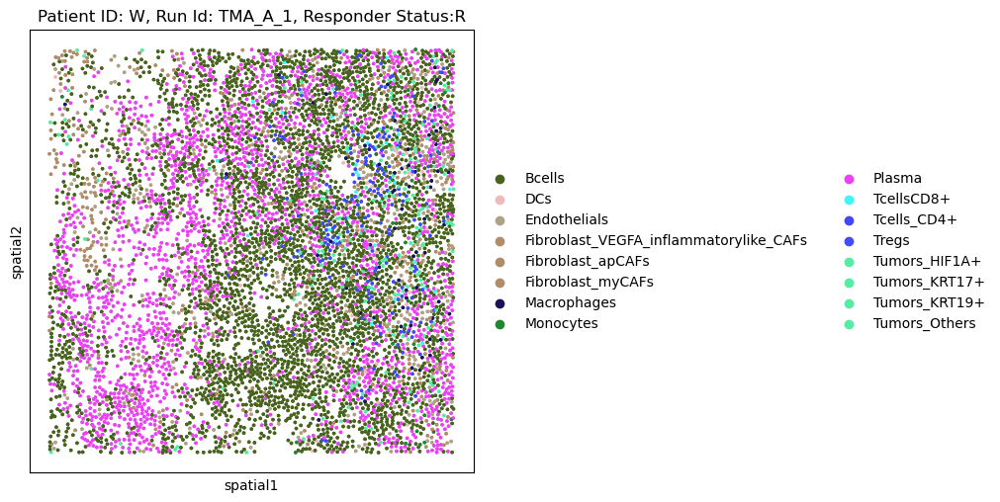

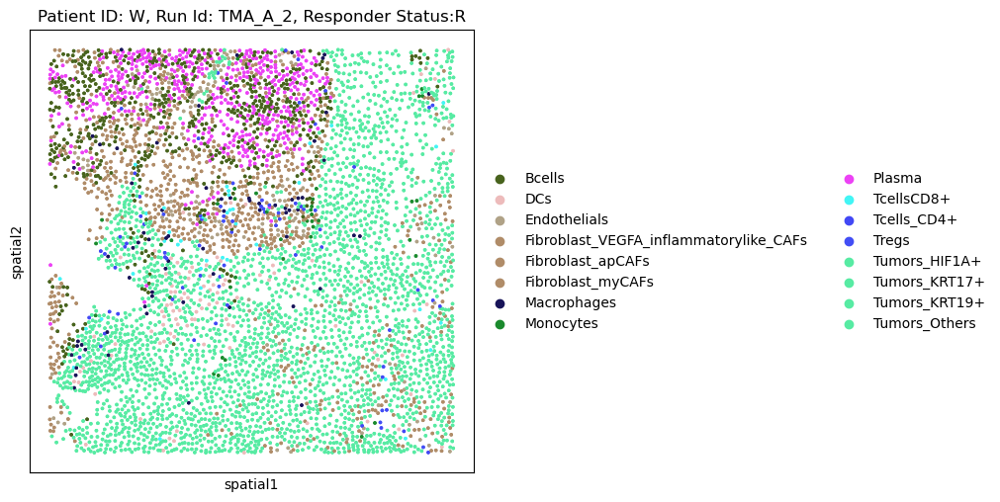

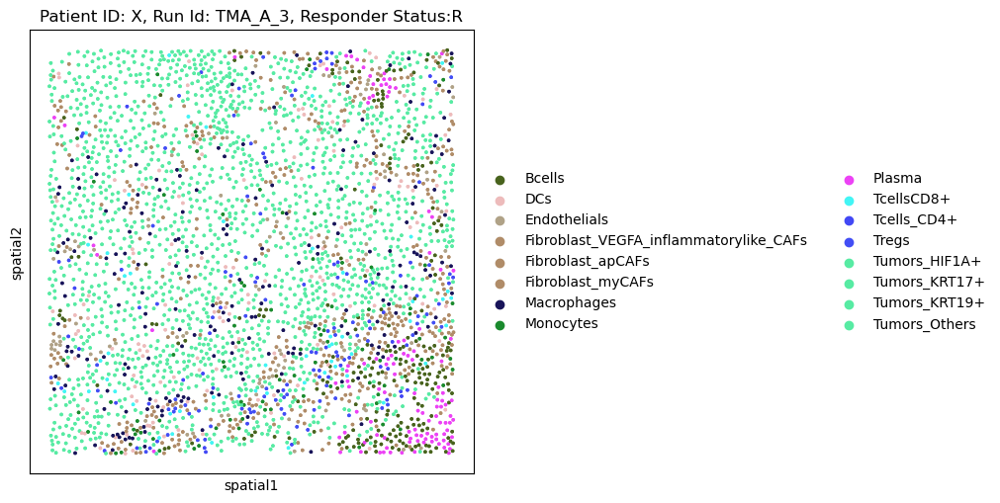

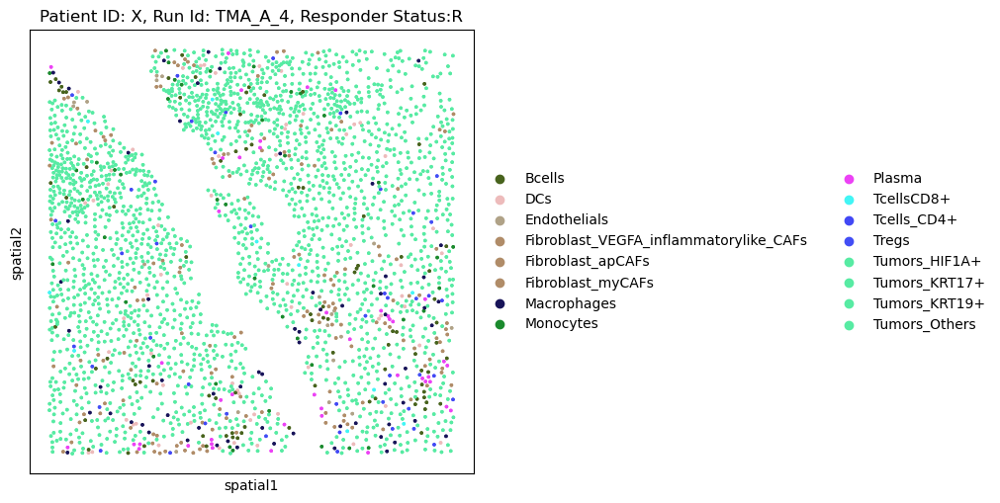

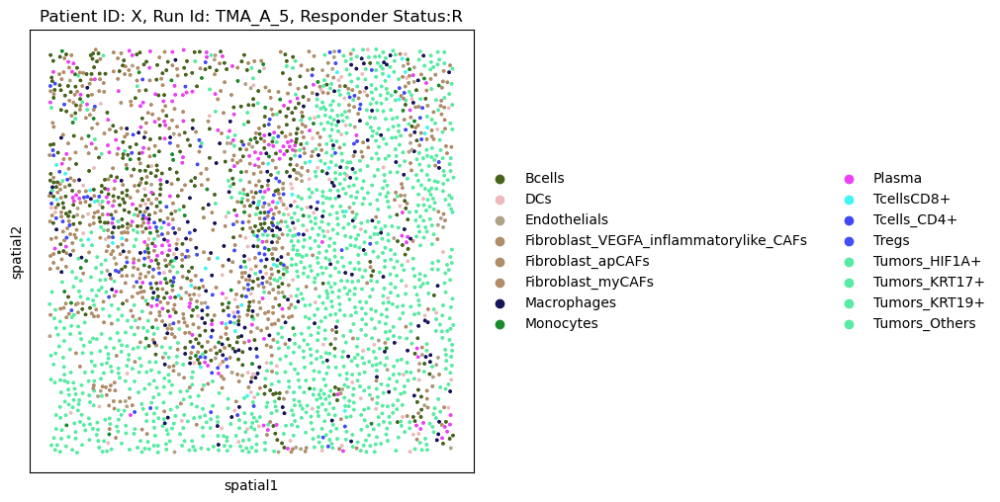

...

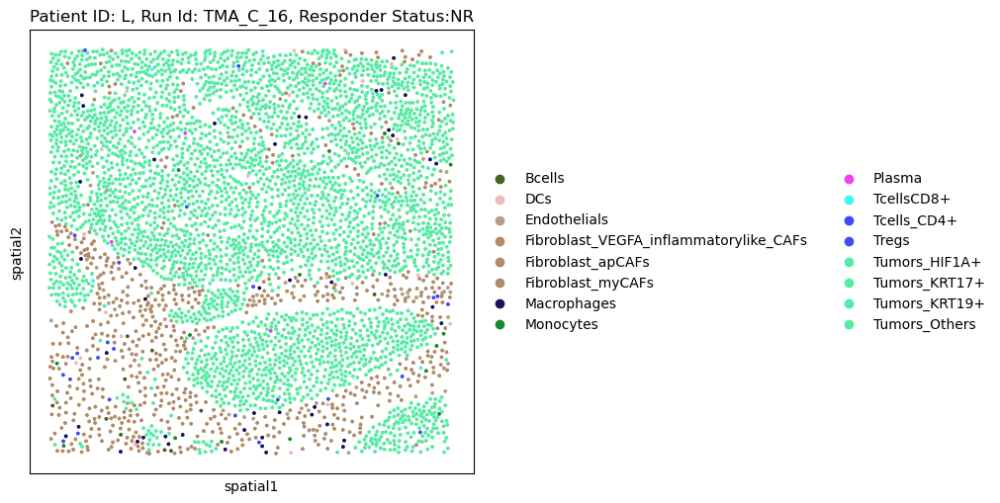

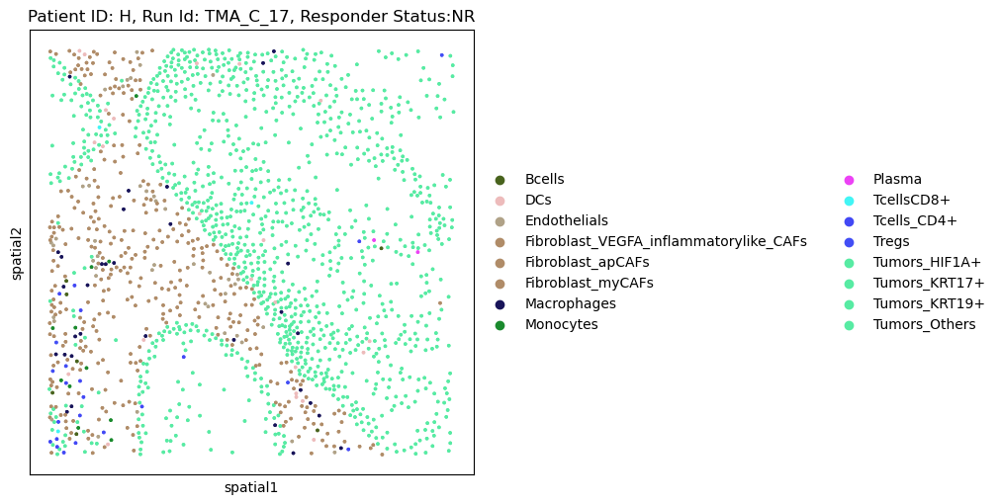

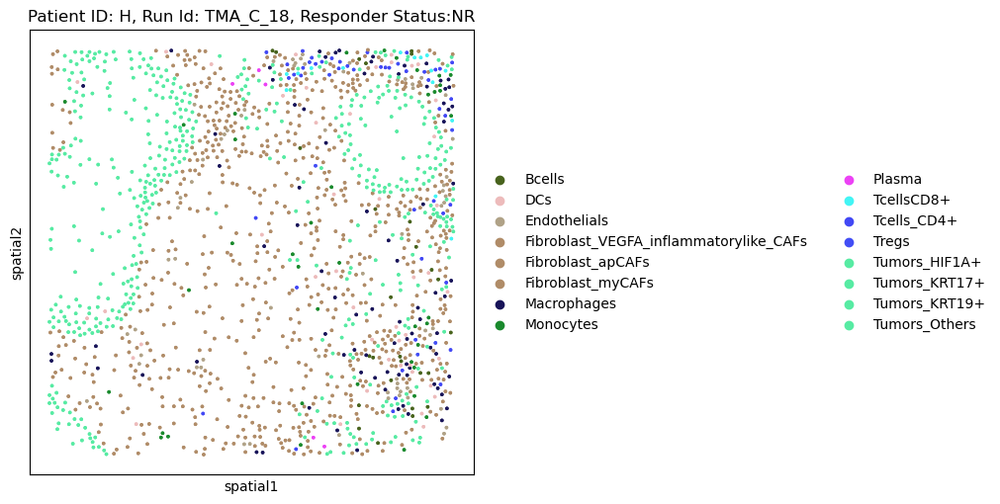

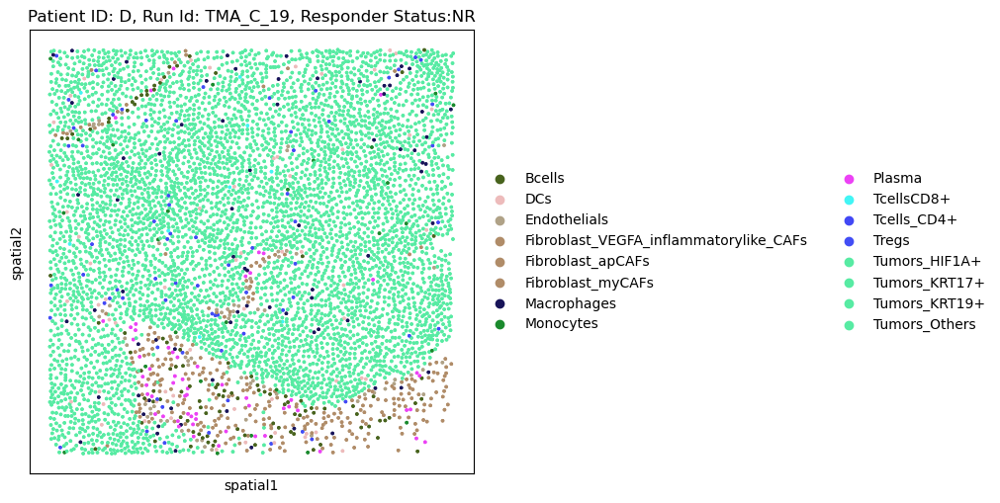

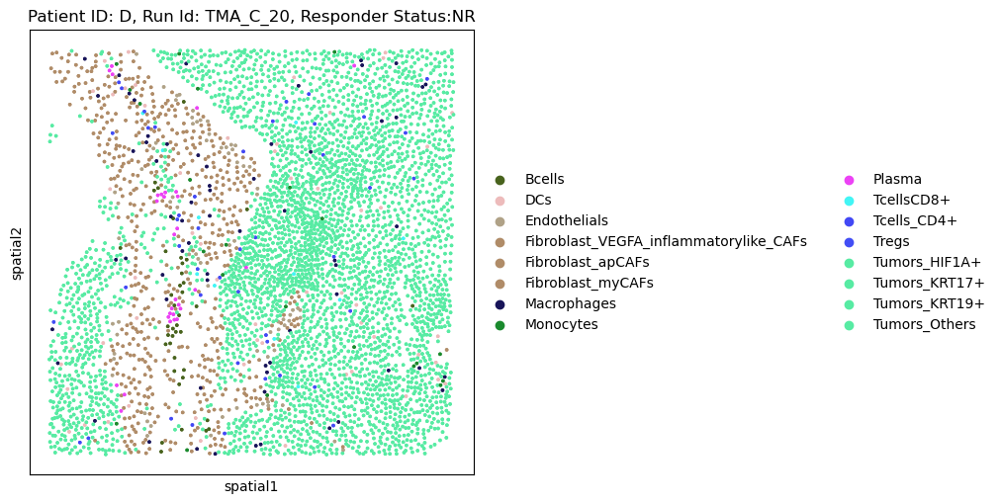

In [21]:
import squidpy as sq
import warnings
warnings.filterwarnings("ignore")

# Color scheme
BCELL_COLOR = "#48631d"
CD4_COLOR = "#42f5f5"
CD8_COLOR = "#4248f5"
DCs_COLOR = "#edbbbb"
FIBROBLASTS_COLOR = "#b08c68"
MACROPHAGE_COLOR = "#181459"
MONOCYTES_COLOR = "#1a8a2d"
NK_COLOR = "#f542bf"
PLASMA_COLOR = "#ec42f5"
TREG_COLOR = "#424ef5"
TUMOR_COLOR = "#57eba3"
ENDO_COLOR = "#b0a287"
OTHER_COLOR = "#d9d9d9"
FIBROBLAST_VEGFA_COLOR = "#b08c68"
FIBROBLAST_APCAFS_COLOR = "#b08c68"
FIBROBLAST_MYCAFS_COLOR = "#b08c68"
TUMORS_HIF1A_COLOR = "#57eba3"
TUMORS_KRT17_COLOR = "#57eba3"
TUMORS_KRT19_COLOR = "#57eba3"
TUMORS_OTHER_COLOR = "#57eba3"

# Full color mapping
cell_type_colors = {
    "Neutrophils": NEUTROPHIL_COLOR,
    "Bcells": BCELL_COLOR,
    "TcellsCD8+": CD4_COLOR,
    "Tcells_CD4+": CD8_COLOR,
    "DCs": DCs_COLOR,
    "Fibroblasts/SMCs": FIBROBLASTS_COLOR,
    "Macrophages": MACROPHAGE_COLOR,
    "Monocytes": MONOCYTES_COLOR,
    "NK_cells": NK_COLOR,
    "Plasma": PLASMA_COLOR,
    "Tregs": TREG_COLOR,
    "Endothelials": ENDO_COLOR,
    "Fibroblast_myCAFs": FIBROBLAST_MYCAFS_COLOR,
    "Fibroblast_apCAFs": FIBROBLAST_APCAFS_COLOR,
    "Fibroblast_VEGFA_inflammatorylike_CAFs": FIBROBLAST_VEGFA_COLOR,
    "Tumors_HIF1A+": TUMORS_HIF1A_COLOR,
    "Tumors_KRT17+": TUMORS_KRT17_COLOR,
    "Tumors_KRT19+": TUMORS_KRT19_COLOR,
    "Tumors_Others": TUMORS_OTHER_COLOR
}

TMA_ids=["A", "B", "C"]

for j in TMA_ids:
    for i in range(1, 50):
        cell_ID_like =f"TMA_{j}_FOV{i}(?!\d)"
        subset = adata[adata.obs.tma_fov_id.str.contains(cell_ID_like)]
        
        # Skip if no matching cells are found
        if subset.n_obs == 0:
            continue
    
        # Get the unique patient ID (assumes only one per subset)
        patient_id = subset.obs["PatientID"].unique()[0]
        response_status = subset.obs["Response"].unique()[0]

        # Convert to categorical without setting all 12 types
        subset.obs["annot_cluster2"] = subset.obs["annot_cluster2"].astype("category")

        # Get the actual order of categories used in the subset
        category_order = subset.obs["annot_cluster2"].cat.categories.tolist()
        
        # Generate color list in the exact same order
        color_list = [
            cell_type_colors.get(ct, OTHER_COLOR)
            for ct in category_order
        ]

        # Set the colors in the correct order
        subset.uns["annot_cluster2_colors"] = color_list
        
        # Plot with dynamic title
        sq.pl.spatial_scatter(
            subset,
            shape=None,
            color="annot_cluster2",
            size=10,
            title=f"Patient ID: {patient_id}, Run Id: TMA_{j}_{i}, Responder Status:{response_status}",
            figsize=(10, 8),  # or larger
            legend_loc='right margin'  # move legend out of plot area
        )

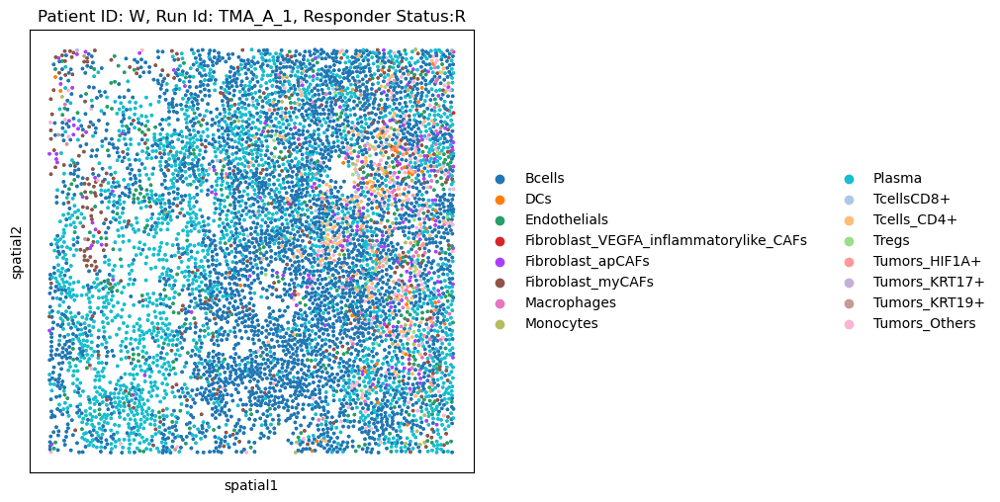

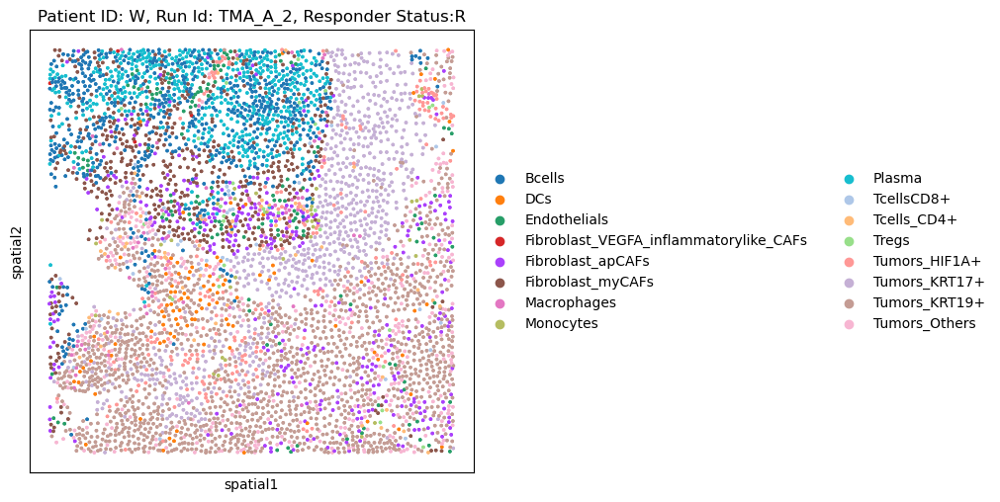

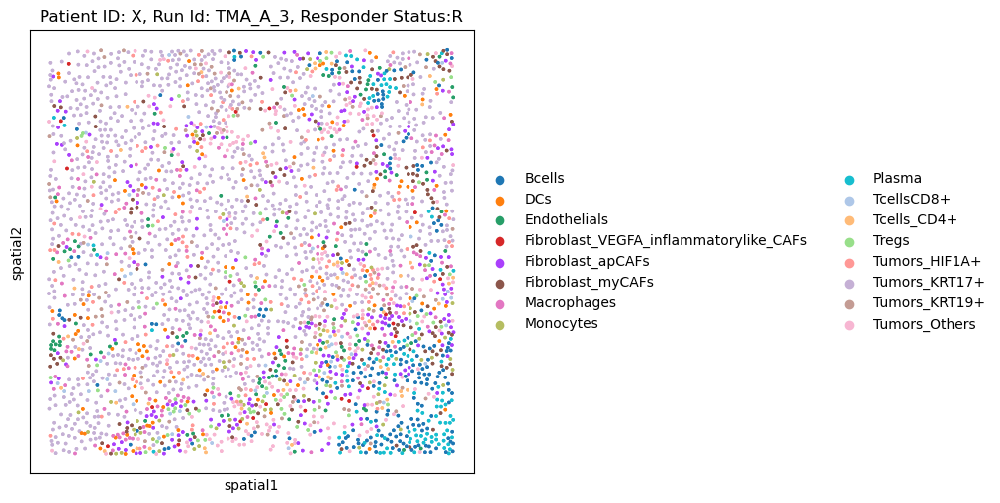

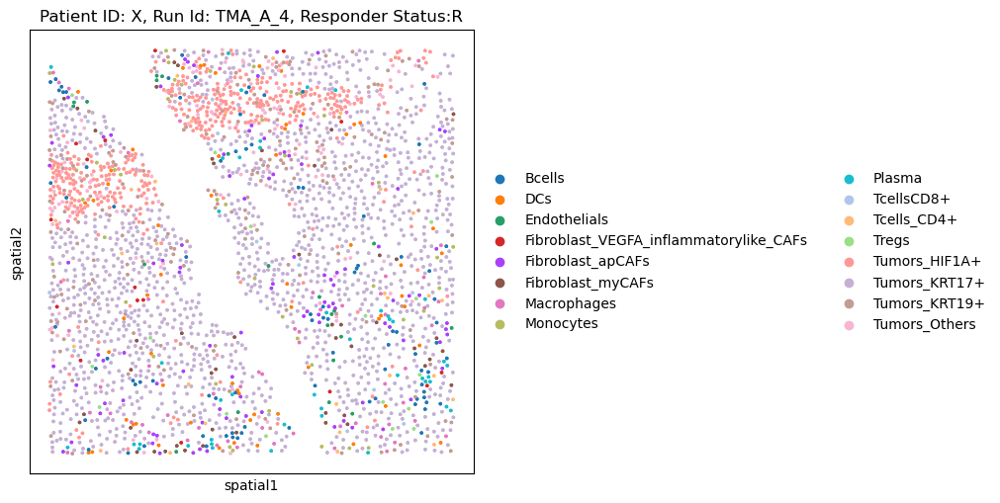

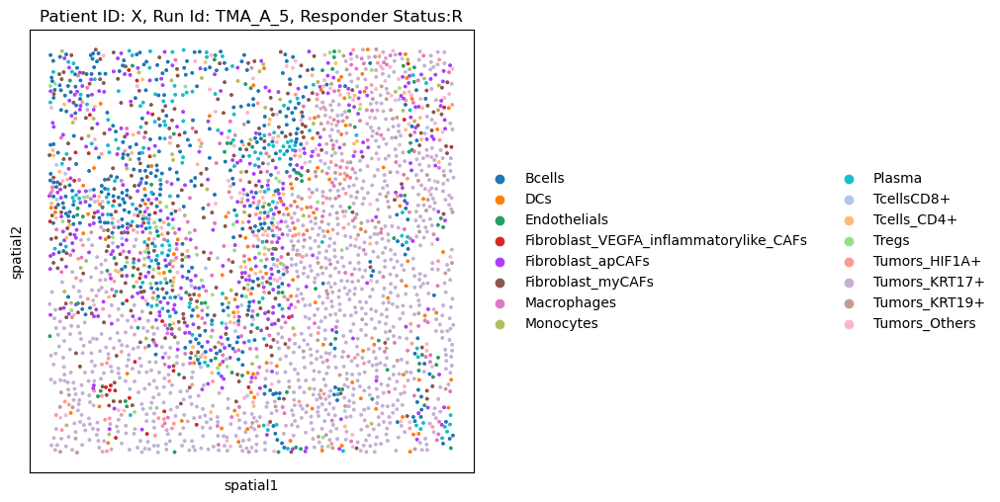

...

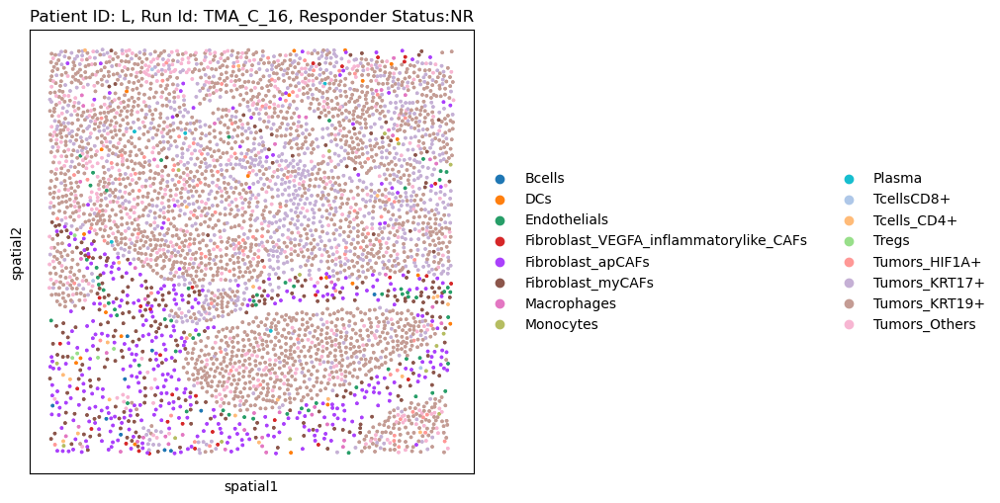

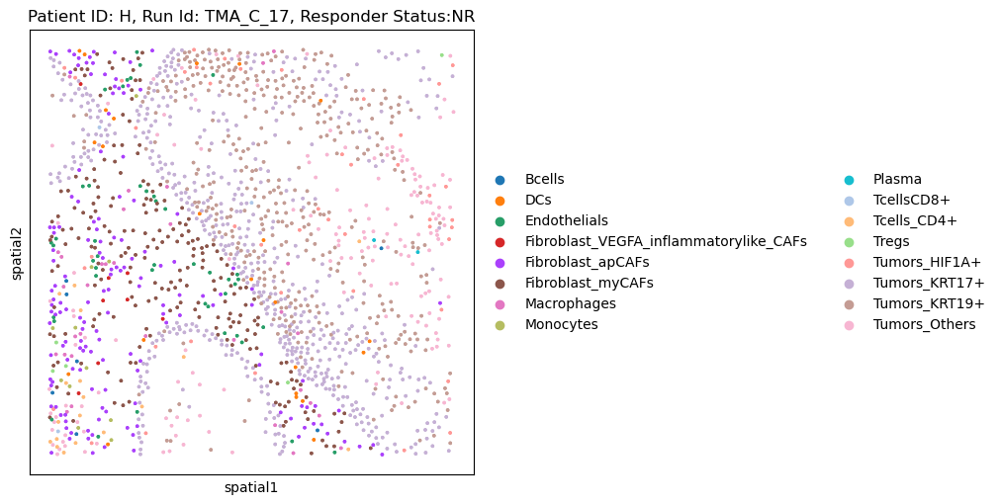

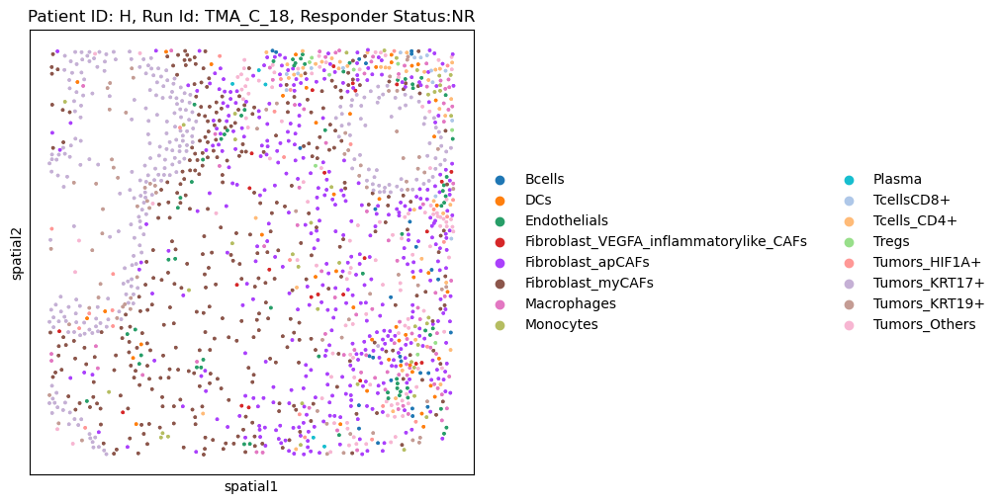

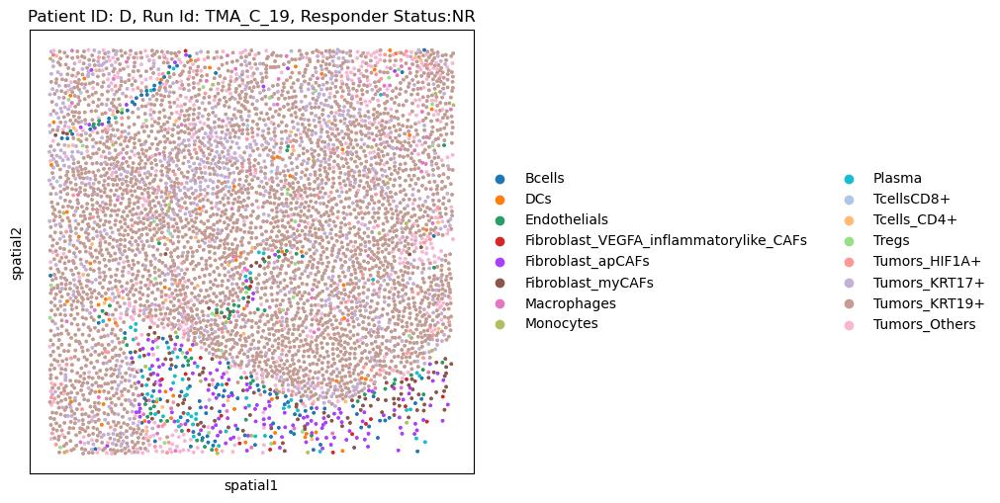

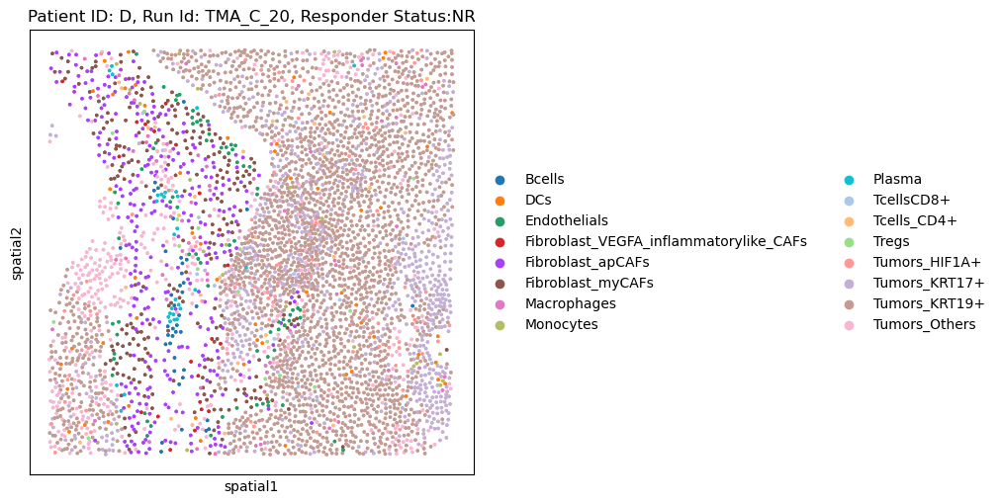

In [19]:
import squidpy as sq
import warnings
warnings.filterwarnings("ignore")

TMA_ids=["A", "B", "C"]

for j in TMA_ids:
    for i in range(1, 50):
        cell_ID_like =f"TMA_{j}_FOV{i}(?!\d)"
        subset = adata[adata.obs.tma_fov_id.str.contains(cell_ID_like)]
        
        # Skip if no matching cells are found
        if subset.n_obs == 0:
            continue
    
        # Get the unique patient ID (assumes only one per subset)
        patient_id = subset.obs["PatientID"].unique()[0]
        response_status = subset.obs["Response"].unique()[0]

    
        # Plot with dynamic title
        sq.pl.spatial_scatter(
            subset,
            shape=None,
            color="annot_cluster2",
            size=10,
            title=f"Patient ID: {patient_id}, Run Id: TMA_{j}_{i}, Responder Status:{response_status}",
            figsize=(10, 8),  # or larger
            legend_loc='right margin'  # move legend out of plot area
        )

In [44]:
# Add spatial coordinates and UMAP to .obsm
adata.obsm["spatial"] = umap.values  # adjust if needed
# x_pixel, y_pixel, x_norm	y_norm	x_micron	y_micron x_cent	y_cent

adata.obsm["X_umap"] = umap.values

In [ ]:
import squidpy as sq
import warnings
warnings.filterwarnings("ignore")

TMA_ids=["A", "B", "C"]

for j in TMA_ids:
    for i in range(1, 50):
        cell_ID_like =f"TMA_{j}_FOV{i}(?!\d)"
        subset = adata[adata.obs.tma_fov_id.str.contains(cell_ID_like)]
        
        # Skip if no matching cells are found
        if subset.n_obs == 0:
            continue
    
        # Get the unique patient ID (assumes only one per subset)
        patient_id = subset.obs["PatientID"].unique()[0]
        response_status = subset.obs["Response"].unique()[0]

    
        # Plot with dynamic title
        sq.pl.spatial_scatter(
            subset,
            shape=None,
            color="annot_cluster2",
            size=6,
            title=f"Patient ID: {patient_id}, Run Id: TMA_{j}_{i}, Responder Status:{response_status}",
            figsize=(10, 8),  # or larger
            legend_loc='right margin'  # move legend out of plot area
        )

In [1]:
import numpy as np

# Makes subset of the adata object
adata_sub = adata[adata.obs.cell_ID.str.contains("TMAA_.+?_1(?!\d)")].copy()

# Ensure 'cell type' is categorical 
adata_sub.obs['predicted.id'] = adata_sub.obs['predicted.id'].astype('category')

for key in ['spatial_connectivities', 'spatial_distances']:
    if key in adata_sub.obsp:
        del adata_sub.obsp[key]

if 'spatial' in adata_sub.uns:
    del adata_sub.uns['spatial']
finite_mask = np.isfinite(adata_sub.obsm['spatial']).all(axis=1)
adata_sub = adata_sub[finite_mask].copy()

# Compute spatial neighbors on the subset
sq.gr.spatial_neighbors(adata_sub, coord_type="generic", spatial_key="spatial")

# Run neighborhood enrichment on the subset
sq.gr.nhood_enrichment(adata_sub, cluster_key="predicted.id")

# Plot neighborhood enrichment results from the subset
sq.pl.nhood_enrichment(
    adata_sub, 
    cluster_key="predicted.id", 
    method="single", 
    cmap="plasma", 
)                                                              

NameError: name 'adata' is not defined